# Working Group C - Group Assignment

<a href="https://colab.research.google.com/github/Krauthini/MLII/GroupC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# RUN these cells to install the necessary libraries when using Google Colab!

In [ ]:
repository_name = "ML2-MBD-EN-OCT-2021-S-1"
repository_url = 'https://github.com/Krauthini/MLII

In [ ]:
! git clone $repository_url

In [ ]:
! pip install -Uqqr $repository_name/requirements.txt

In [ ]:
%cd $repository_name/tree_based_practice

In [ ]:
from IPython.core.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>")) # Increase cell width
display(HTML("<style>.rendered_html { font-size: 16px; }</style>")) # Increase font size

# Larger figures

In [23]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt

import seaborn as sns
%matplotlib inline

In [8]:
df = pd.read_csv('train.csv', index_col='Id')
df.head()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
Id,,,,,,,,,,,,,,,,,,,,,
1,2596,51,3,258,0,510,221,232,148,6279,...,0,0,0,0,0,0,0,0,0,5
2,2590,56,2,212,-6,390,220,235,151,6225,...,0,0,0,0,0,0,0,0,0,5
3,2804,139,9,268,65,3180,234,238,135,6121,...,0,0,0,0,0,0,0,0,0,2
4,2785,155,18,242,118,3090,238,238,122,6211,...,0,0,0,0,0,0,0,0,0,2
5,2595,45,2,153,-1,391,220,234,150,6172,...,0,0,0,0,0,0,0,0,0,5


### Features:
- Elevation - Elevation in meters
- Aspect - Aspect in degrees azimuth
- Slope - Slope in degrees
- Horizontal_Distance_To_Hydrology - Horz Dist to nearest surface water features
- Vertical_Distance_To_Hydrology - Vert Dist to nearest surface water features
- Horizontal_Distance_To_Roadways - Horz Dist to nearest roadway
- Hillshade_9am (0 to 255 index) - Hillshade index at 9am, summer solstice
- Hillshade_Noon (0 to 255 index) - Hillshade index at noon, summer solstice
- Hillshade_3pm (0 to 255 index) - Hillshade index at 3pm, summer solstice
- Horizontal_Distance_To_Fire_Points - Horz Dist to nearest wildfire ignition points
- Wilderness_Area (4 binary columns, 0 = absence or 1 = presence) - Wilderness area designation
    - 1 - Rawah Wilderness Area
    - 2 - Neota Wilderness Area
    - 3 - Comanche Peak Wilderness Area
    - 4 - Cache la Poudre Wilderness Area
- Soil_Type (40 binary columns, 0 = absence or 1 = presence) - Soil Type designation
    - 1 Cathedral family - Rock outcrop complex, extremely stony.
    - 2 Vanet - Ratake families complex, very stony.
    - 3 Haploborolis - Rock outcrop complex, rubbly.
    - 4 Ratake family - Rock outcrop complex, rubbly.
    - 5 Vanet family - Rock outcrop complex complex, rubbly.
    - 6 Vanet - Wetmore families - Rock outcrop complex, stony.
    - 7 Gothic family.
    - 8 Supervisor - Limber families complex.
    - 9 Troutville family, very stony.
    - 10 Bullwark - Catamount families - Rock outcrop complex, rubbly.
    - 11 Bullwark - Catamount families - Rock land complex, rubbly.
    - 12 Legault family - Rock land complex, stony.
    - 13 Catamount family - Rock land - Bullwark family complex, rubbly.
    - 14 Pachic Argiborolis - Aquolis complex.
    - 15 unspecified in the USFS Soil and ELU Survey.
    - 16 Cryaquolis - Cryoborolis complex.
    - 17 Gateview family - Cryaquolis complex.
    - 18 Rogert family, very stony.
    - 19 Typic Cryaquolis - Borohemists complex.
    - 20 Typic Cryaquepts - Typic Cryaquolls complex.
    - 21 Typic Cryaquolls - Leighcan family, till substratum complex.
    - 22 Leighcan family, till substratum, extremely bouldery.
    - 23 Leighcan family, till substratum - Typic Cryaquolls complex.
    - 24 Leighcan family, extremely stony.
    - 25 Leighcan family, warm, extremely stony.
    - 26 Granile - Catamount families complex, very stony.
    - 27 Leighcan family, warm - Rock outcrop complex, extremely stony.
    - 28 Leighcan family - Rock outcrop complex, extremely stony.
    - 29 Como - Legault families complex, extremely stony.
    - 30 Como family - Rock land - Legault family complex, extremely stony.
    - 31 Leighcan - Catamount families complex, extremely stony.
    - 32 Catamount family - Rock outcrop - Leighcan family complex, extremely stony.
    - 33 Leighcan - Catamount families - Rock outcrop complex, extremely stony.
    - 34 Cryorthents - Rock land complex, extremely stony.
    - 35 Cryumbrepts - Rock outcrop - Cryaquepts complex.
    - 36 Bross family - Rock land - Cryumbrepts complex, extremely stony.
    - 37 Rock outcrop - Cryumbrepts - Cryorthents complex, extremely stony.
    - 38 Leighcan - Moran families - Cryaquolls complex, extremely stony.
    - 39 Moran family - Cryorthents - Leighcan family complex, extremely stony.
    - 40 Moran family - Cryorthents - Rock land complex, extremely stony.

#### To predict:
- Cover_Type (7 types, integers 1 to 7) - Forest Cover Type designation
    - 1 - Spruce/Fir
    - 2 - Lodgepole Pine
    - 3 - Ponderosa Pine
    - 4 - Cottonwood/Willow
    - 5 - Aspen
    - 6 - Douglas-fir
    - 7 - Krummholz

In [9]:
profile = ProfileReport(df, title="Pandas Profiling Report", minimal=False)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 2. Data cleaning: preparing the data and analyzing it.

In [10]:
df.columns

Index(['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points', 'Wilderness_Area1',
       'Wilderness_Area2', 'Wilderness_Area3', 'Wilderness_Area4',
       'Soil_Type1', 'Soil_Type2', 'Soil_Type3', 'Soil_Type4', 'Soil_Type5',
       'Soil_Type6', 'Soil_Type7', 'Soil_Type8', 'Soil_Type9', 'Soil_Type10',
       'Soil_Type11', 'Soil_Type12', 'Soil_Type13', 'Soil_Type14',
       'Soil_Type15', 'Soil_Type16', 'Soil_Type17', 'Soil_Type18',
       'Soil_Type19', 'Soil_Type20', 'Soil_Type21', 'Soil_Type22',
       'Soil_Type23', 'Soil_Type24', 'Soil_Type25', 'Soil_Type26',
       'Soil_Type27', 'Soil_Type28', 'Soil_Type29', 'Soil_Type30',
       'Soil_Type31', 'Soil_Type32', 'Soil_Type33', 'Soil_Type34',
       'Soil_Type35', 'Soil_Type36', 'Soil_Type37', 'Soil_Type38',
       'Soil_Type39', 'Soil_Type40

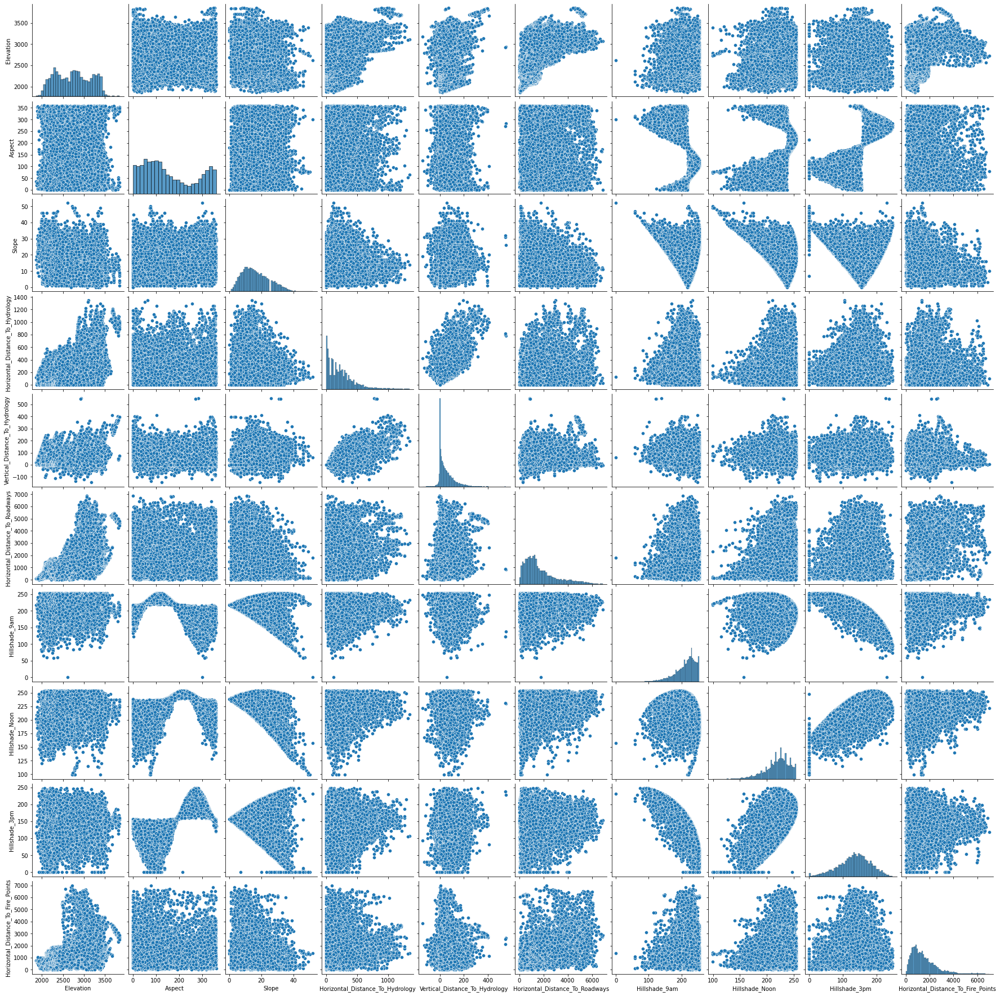

In [13]:
# checking distributions of data
cols_for_distrib = [
    'Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology',
       'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways',
       'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm',
       'Horizontal_Distance_To_Fire_Points'
]
sns.pairplot(df[cols_for_distrib]);

In [14]:
df.isna().sum()

Elevation                             0
Aspect                                0
Slope                                 0
Horizontal_Distance_To_Hydrology      0
Vertical_Distance_To_Hydrology        0
Horizontal_Distance_To_Roadways       0
Hillshade_9am                         0
Hillshade_Noon                        0
Hillshade_3pm                         0
Horizontal_Distance_To_Fire_Points    0
Wilderness_Area1                      0
Wilderness_Area2                      0
Wilderness_Area3                      0
Wilderness_Area4                      0
Soil_Type1                            0
Soil_Type2                            0
Soil_Type3                            0
Soil_Type4                            0
Soil_Type5                            0
Soil_Type6                            0
Soil_Type7                            0
Soil_Type8                            0
Soil_Type9                            0
Soil_Type10                           0
Soil_Type11                           0


---

# 3. Feature engineering

# 4. Model training: training the model

In [18]:
from sklearn.tree import DecisionTreeClassifier

In [26]:
from sklearn.model_selection import cross_val_score

In [20]:
X = df.drop(columns='Cover_Type')
y = df['Cover_Type']

In [27]:
cover_tree  = DecisionTreeClassifier(random_state=42)
print("Accuracy = {0:.4f}".format(np.mean(cross_val_score(cover_tree, X, y))))

Accuracy = 0.7060


In [32]:
from sklearn.model_selection import GridSearchCV
param_grid = {'max_depth': range(10,30)}

cover_tree_pruned_cv = GridSearchCV(cover_tree, 
                   param_grid,
                   scoring='accuracy',
                   cv=10 , n_jobs=1, verbose=1)

cover_tree_pruned_cv.fit(X,y)
print("Best parameters set found on development set:")
print()
print(cover_tree_pruned_cv.best_params_)
print()
print("Grid scores on development set:")
print()
means = cover_tree_pruned_cv.cv_results_['mean_test_score']
stds = cover_tree_pruned_cv.cv_results_['std_test_score']
for mean, std, params in zip(means, stds, cover_tree_pruned_cv.cv_results_['params']):
    print("Accuracy = %0.3f (+/%0.03f) for %r" % (mean, std * 2, params))

Fitting 10 folds for each of 20 candidates, totalling 200 fits
Best parameters set found on development set:

{'max_depth': 20}

Grid scores on development set:

Accuracy = 0.698 (+/0.092) for {'max_depth': 10}
Accuracy = 0.698 (+/0.103) for {'max_depth': 11}
Accuracy = 0.706 (+/0.090) for {'max_depth': 12}
Accuracy = 0.713 (+/0.093) for {'max_depth': 13}
Accuracy = 0.713 (+/0.085) for {'max_depth': 14}
Accuracy = 0.709 (+/0.087) for {'max_depth': 15}
Accuracy = 0.713 (+/0.085) for {'max_depth': 16}
Accuracy = 0.714 (+/0.079) for {'max_depth': 17}
Accuracy = 0.710 (+/0.085) for {'max_depth': 18}
Accuracy = 0.714 (+/0.082) for {'max_depth': 19}
Accuracy = 0.714 (+/0.078) for {'max_depth': 20}
Accuracy = 0.712 (+/0.081) for {'max_depth': 21}
Accuracy = 0.710 (+/0.082) for {'max_depth': 22}
Accuracy = 0.712 (+/0.083) for {'max_depth': 23}
Accuracy = 0.713 (+/0.079) for {'max_depth': 24}
Accuracy = 0.713 (+/0.082) for {'max_depth': 25}
Accuracy = 0.711 (+/0.080) for {'max_depth': 26}
Accur

In [35]:
cover_tree_pruned  = DecisionTreeClassifier(random_state=42, max_depth=20)
print("Accuracy = {0:.4f}".format(np.mean(cross_val_score(cover_tree_pruned, X, y))))

Accuracy = 0.7076


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.185044 to fit



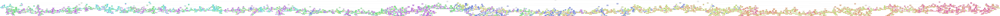

In [36]:
from io import StringIO
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus

def plot_tree(tree, feature_names):
    dot_data = StringIO()
    export_graphviz(tree, out_file=dot_data, feature_names=feature_names, filled=True, rounded=True,special_characters=True)
    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
    return Image(graph.create_png())

plot_tree(cover_tree_pruned.fit(X,y), X.columns)

---

### Bagging / Random Forest

In [38]:
from sklearn.ensemble import RandomForestClassifier

In [51]:
cover_bagging = RandomForestClassifier(random_state=42, max_features=len(X.columns))
print("Accuracy = {0:.4f}".format(np.mean(cross_val_score(cover_bagging, X, y))))

Accuracy = 0.7810


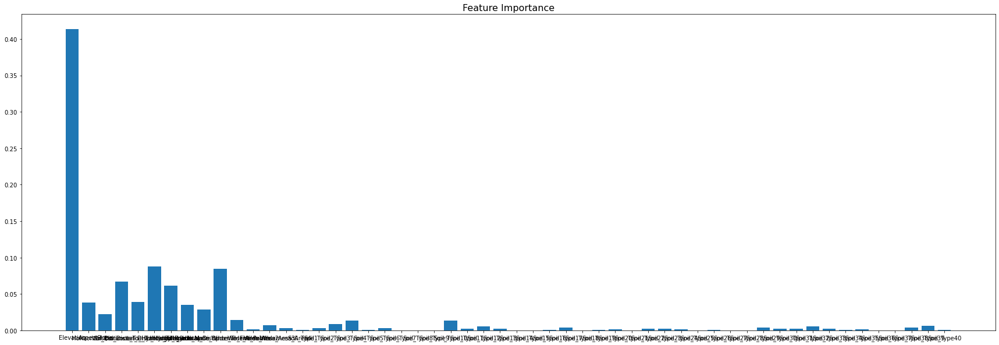

In [43]:
plt.figure(figsize=(30,10))
cover_bagging.fit(X,y)
plt.bar(X.columns, cover_bagging.feature_importances_)
plt.title('Feature Importance', fontsize=16);

In [48]:
cover_rf = RandomForestClassifier(random_state=42, max_features='sqrt')
print("Accuracy = {0:.4f}".format(np.mean(cross_val_score(cover_rf, X, y))))

Accuracy = 0.7827


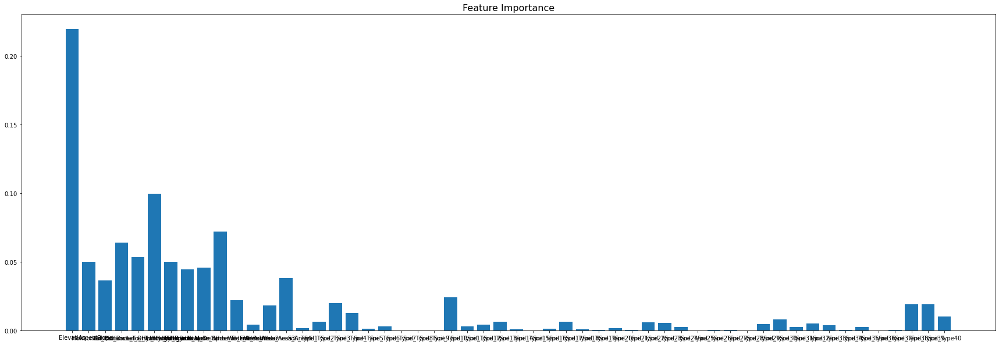

In [44]:
plt.figure(figsize=(30,10))
cover_rf.fit(X,y)
plt.bar(X.columns, cover_rf.feature_importances_)
plt.title('Feature Importance', fontsize=16);